# PW 1 - Practical work on SAR imaging : introduction to SAR data and interferometric processing 

*Author: Benjamin TERNOT*

The aim of this PW is to get familiar with SAR data (high dynamic of the images, complex data with ampltidue and phase). After a first part on the visualization of such data and the understanding of the image content, the second part is dedicated to the processing of phase and interferometric data.

## 1. Analysis of a series of SAR images
In this part, we will have a look at a temporal series of 25 SAR images acquired [from 2015-10-06 to 2016-11-05](https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/PileLely_3072x1024RECALZ4.label), with a time delay of approximately 12 days.

By making use of these SAR images, we will see the main differences with respect to conventional natural images and develop some simple tools to visualize an image, interpret it and detect temporal changes.

In [1]:
#!wget https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py

import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath

plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.max_open_warning'] = 30

In [2]:
# Download of the time series
webpage = 'https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/'
imagename = 'lely_tuple_multitemp.IMA'
imaslc = mvalab.imz2mat(webpage+imagename) # complex image

time_series_amp = np.abs(imaslc[0]) # taking an array of shape [n_rows,n_columns,n_dates] in amplitude format

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.dim
Multitemporal image 25 data
Fichiers PC
Image  complex float
lecture .dim OK -> largeur:512 hauteur:512 profondeur:25
Debug 2 4 512
4 512 <f


### Question 1.1: display a SAR image
SAR images have a long-tailed distribution, making its dynamic range to be wide. Plot the image with matplotlib. What do you see? 

It looks like an optical image with a low exposition and a low contrast. How can you improve the contrast of a SAR image, in order to have a more pleasant visualization?
Implement a function to plot a SAR image and comment the results obtained. 

A usual way to do this, is the saturate all the values above a certain threshold (often chosen as the mean + 3 times the standard deviation of the image) and do a linear stretching for the other values. 
Explain the effect of this processing and what you see in the resulting image. 

### Answer 1.1

- We do not see much, just 3 lights points on the black image.

- By doing so we cut high intensity values that correspond to high reflexion area. Therefore, we will only keep value within the intensity mean, and adapt the contrast to keep some details.

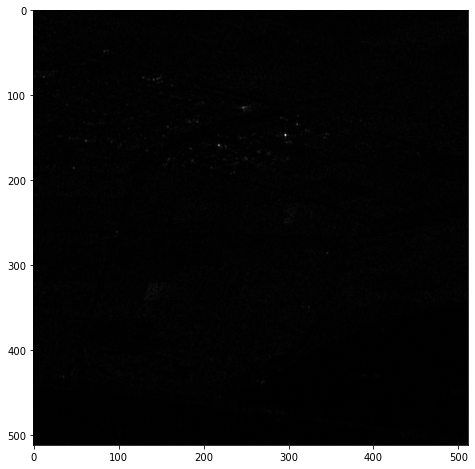

In [3]:
plt.figure()
plt.imshow(time_series_amp[:,:,0],cmap='gray')
plt.show()

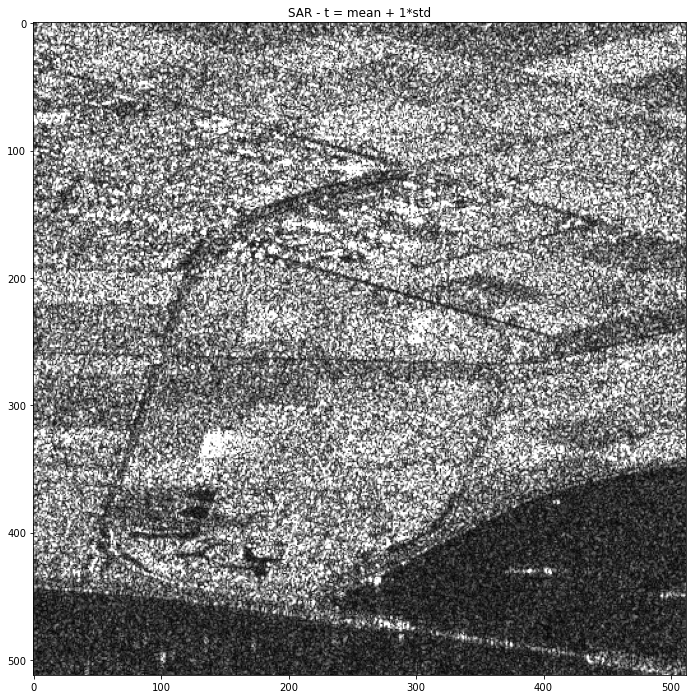

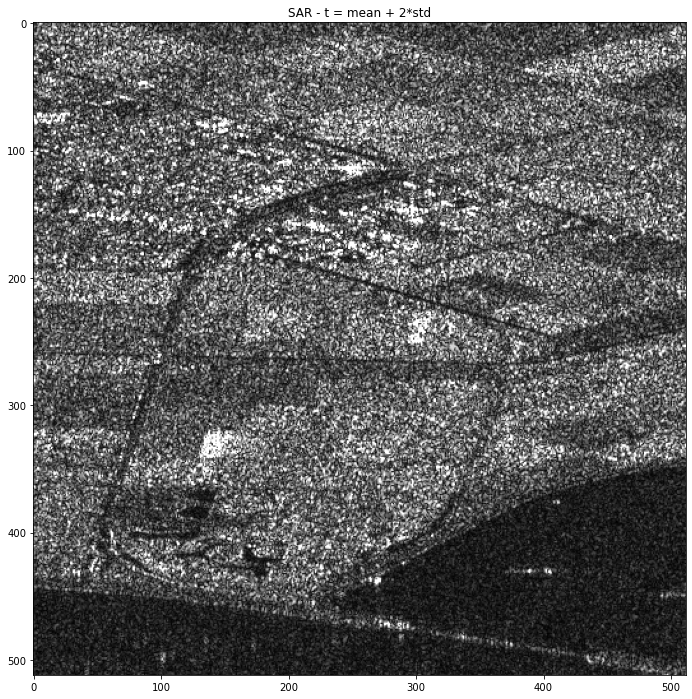

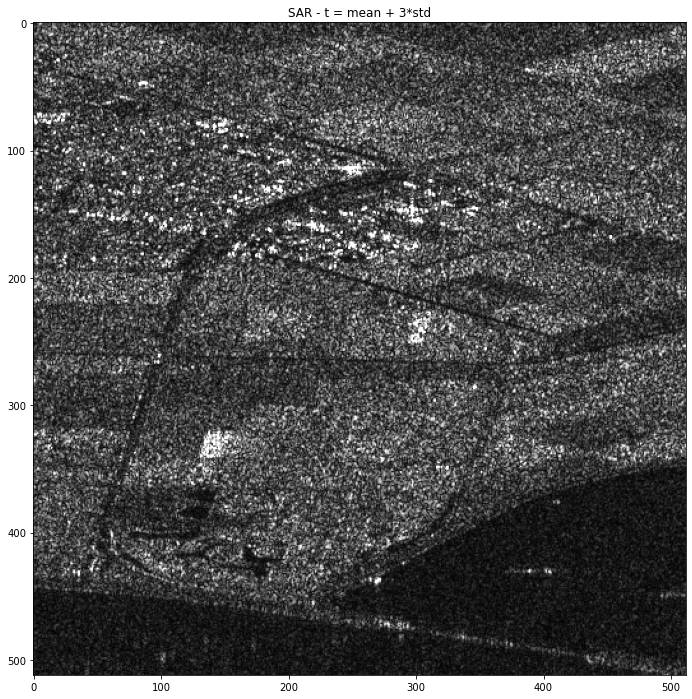

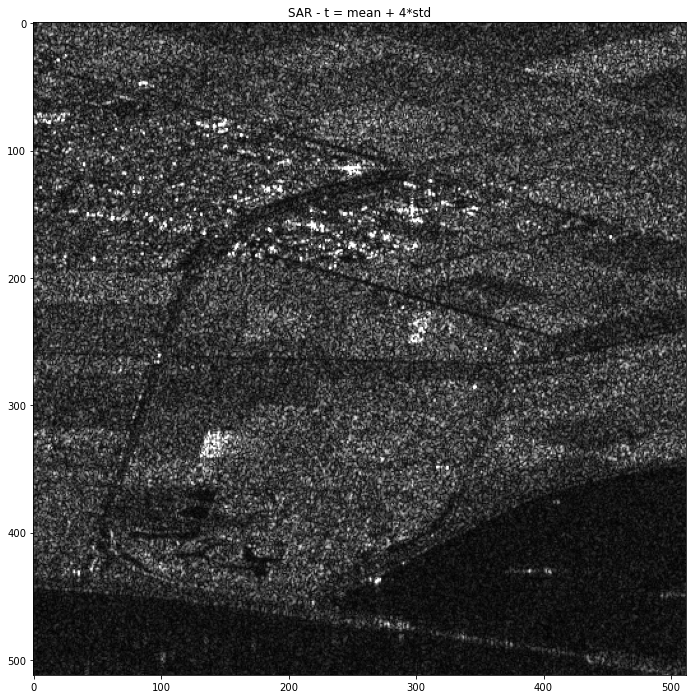

In [10]:
# implement the following function to plot a SAR image
# you can use a threshold as mean + 3 sigma
# and the np.clip function

def plot_sar(ima, k=3):
    plt.figure(figsize=(12,12))
    t = ima.mean() + k * np.std(ima) # choose the appropriate theshold
    plt.imshow(np.clip(ima, 0, t), cmap='gray')
    plt.title(f'SAR - t = mean + {k}*std') # display the saturated image
    plt.show()
for k in range(1, 5):
    plot_sar(time_series_amp[:,:,0], k)

### Question 1.2: Image orientation
Is the image in the correct geographic orientation? 
Apply the proper flipping if necessary.

To see the corresponding optical image and find the correct flipping, you can have a look on Google Maps at [this location](https://goo.gl/maps/LQcd3Uz9U7qCoRrH6).

### Answer 1.2
No, the image is flipped along the vertical axis

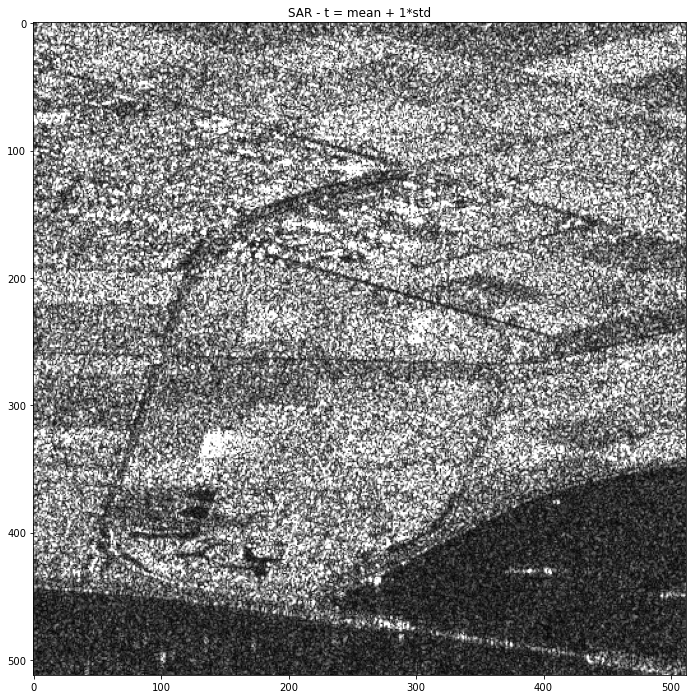

In [5]:
plot_sar(time_series_amp[:,:,0])

In [6]:
time_series_flipped = np.copy(time_series_amp)
time_series_flipped = np.flip(time_series_flipped, axis=1) # apply flipping if necessary using np.flip

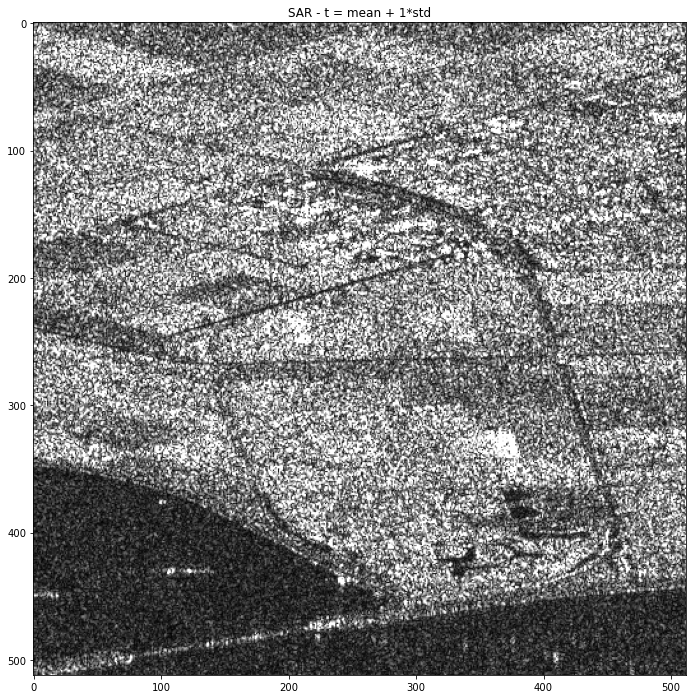

In [7]:
plot_sar(time_series_flipped[:,:,0])

### Question 1.3: Interpretation of a SAR image
The image contains 
- an urban area, 
- agricultural fields, 
- water, 
- moving objects (ships), 
- a bridge 

Explain the appearence of these objects in the SAR image.

### Answer 1.3
- urban area: high density of buildings that have lots of sharp edges leads to high reflexion over the urban area, making it very intense in luminosity 
- agricultural fields: we can see a little difference between each field because of the difference of crops or soil between them
- water: the sea is dark because water deflect the rays and few can come back to the captor
- moving objects (ships): very brights because of the high number of edges that they have
- the bridge: edges of the bridge reflect quite well, compared to the environnent dark area representing the sea.
- note that we clearly see also the electric pylons

### Question 1.4: Multitemporal analysis and change detection
To detect changes occurring between three dates, images can be displayed in a false colour representation, each date being one channel of a RGB image. Implement the function ```plot_changes```.

Then, choose three dates from the multitemporal stack (indexes from 0 to 24). From the false colour representation, can you tell when a particular change has occurred? Explain how you can interpret it.

### Answer 1.4
From the false color representation, we can tell that some objects of the view has changed between the different dates, because if there was no particuliar change, all would have been grey.  
Here, crops are the elements that have changed the most, maybe due to different cultures or stades of growth of the plants.  
Roads or building on the other hand have not changed (or too few).

In [12]:
def plot_changes(im1,im2,im3):
    threshold = (im1.mean() + 3 * np.std(im1) + im2.mean() + 3 * np.std(im2) + im3.mean() + 3 * np.std(im3)) / 3 # select a unique threshold for the three images
    # apply thresholding and shrinking of each image between [0;1] for RGB data
    im1 = np.clip(im1,0,threshold)
    im1 = im1/threshold
    im2 = np.clip(im2,0,threshold)
    im2 = im2/threshold
    im3 = np.clip(im3,0,threshold)
    im3 = im3/threshold
    image = np.stack([im1, im2, im3], axis=2) # create a false RGB image by stacking the three dates
    plt.figure(figsize=(12,12))
    plt.imshow(image)
    plt.show()

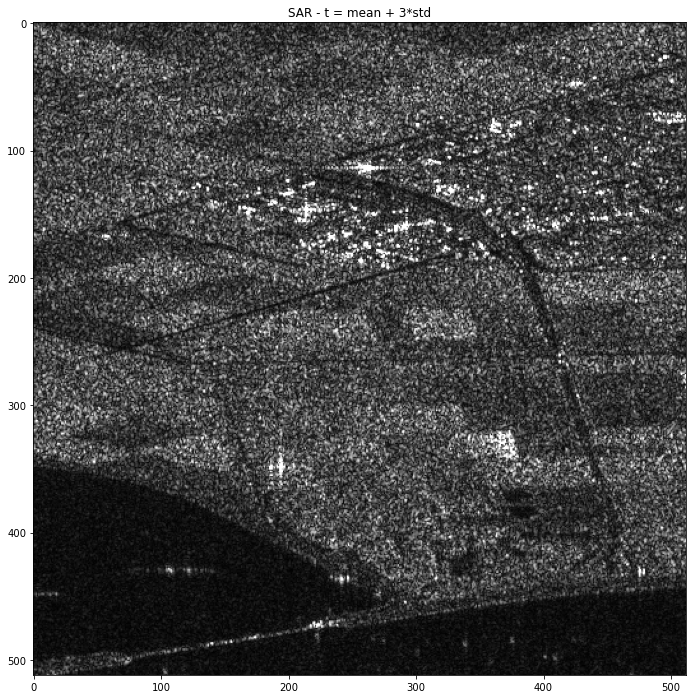

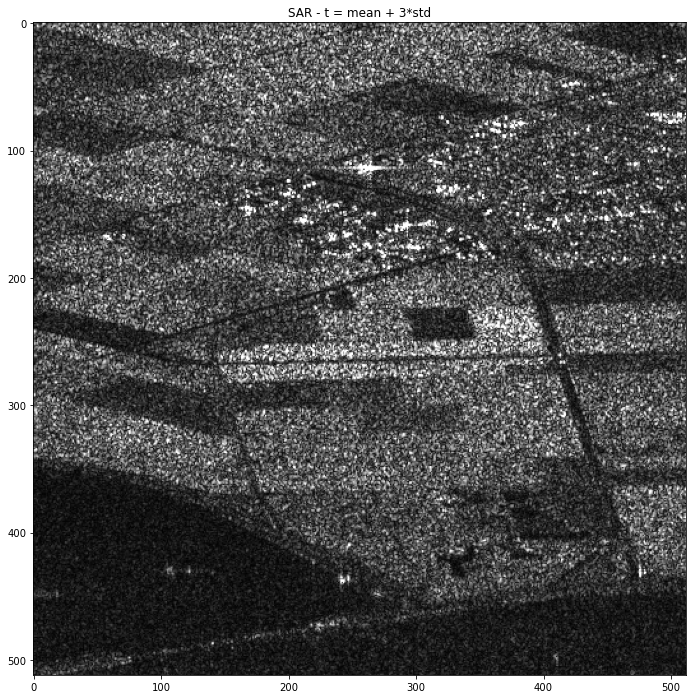

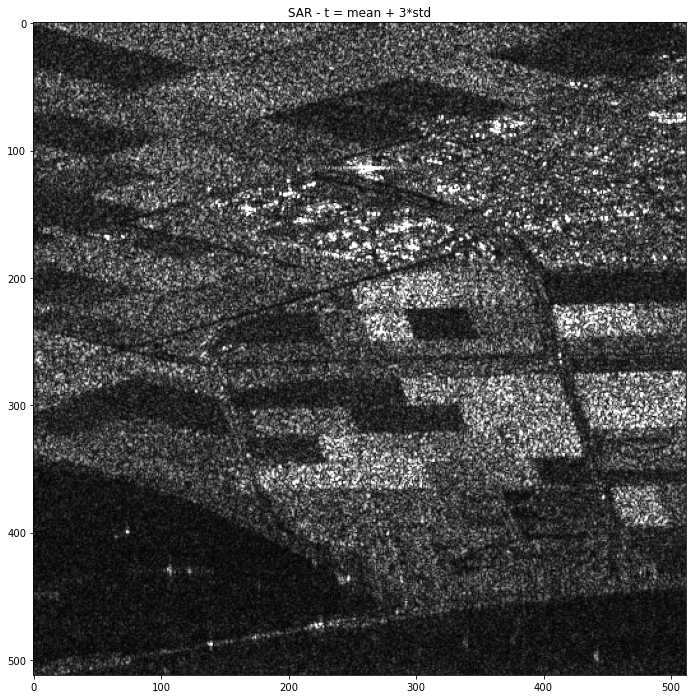

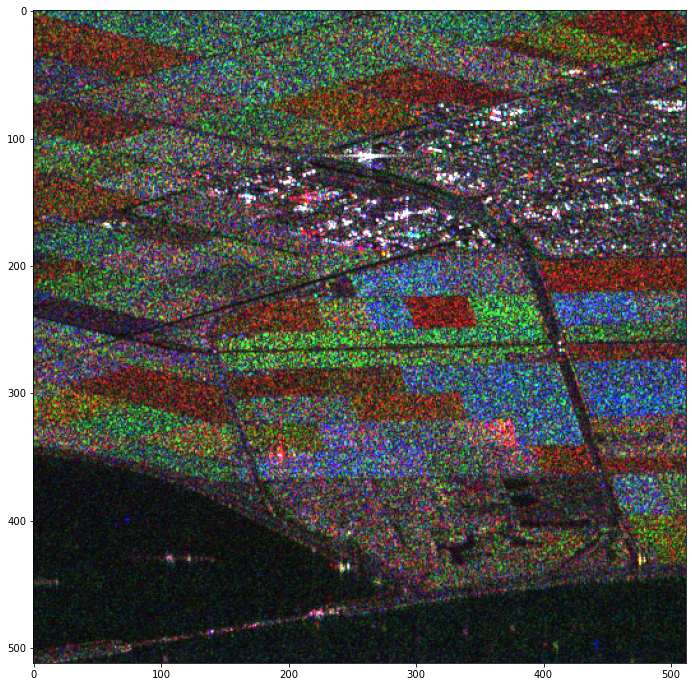

In [11]:
# choose three dates
idx1 = 1 
idx2 = 10 
idx3 = 15
im1 = time_series_flipped[:,:,idx1]
im2 = time_series_flipped[:,:,idx2]
im3 = time_series_flipped[:,:,idx3]

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

### Question 1.5: Create an image with isotropic pixels
The image pixels have the following size: $13.86[m]\times 2.3[m]$ in range $\times$ azimuth (approximately, pixel height is 5 times greater than pixel length). How can you create an image with approximately squared pixels?

### Answer 1.5
We resample the image in the chosen direction with the range and azimuth parameters.

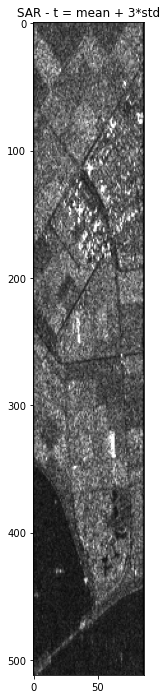

In [15]:
ima_tmp = time_series_flipped[:,:,0]

mask = np.array([[1/6]*6]) 
ima_filtered = scipy.signal.convolve2d(ima_tmp, mask) # filter the image with the appropriate mask
ima_squared_pixels = ima_filtered[:, ::int(13.86//2.3)] # resample the filtered image
plot_sar(ima_squared_pixels)

## 2. Analysis of TerraSAR-X images acquired over the Paris area
In this part we will use an image of TerraSAR-X sensor (metric resolution) of Paris. 
This is a temporal stack, you can choose the date you want. 
(The questions are similar to the previous ones and will not be done during the PW but later as personal work).

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.dim
Multitemporal image 21 data
Fichiers PC
Image  complex short
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:21
Debug 2 2 2048
2 2048 <h
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


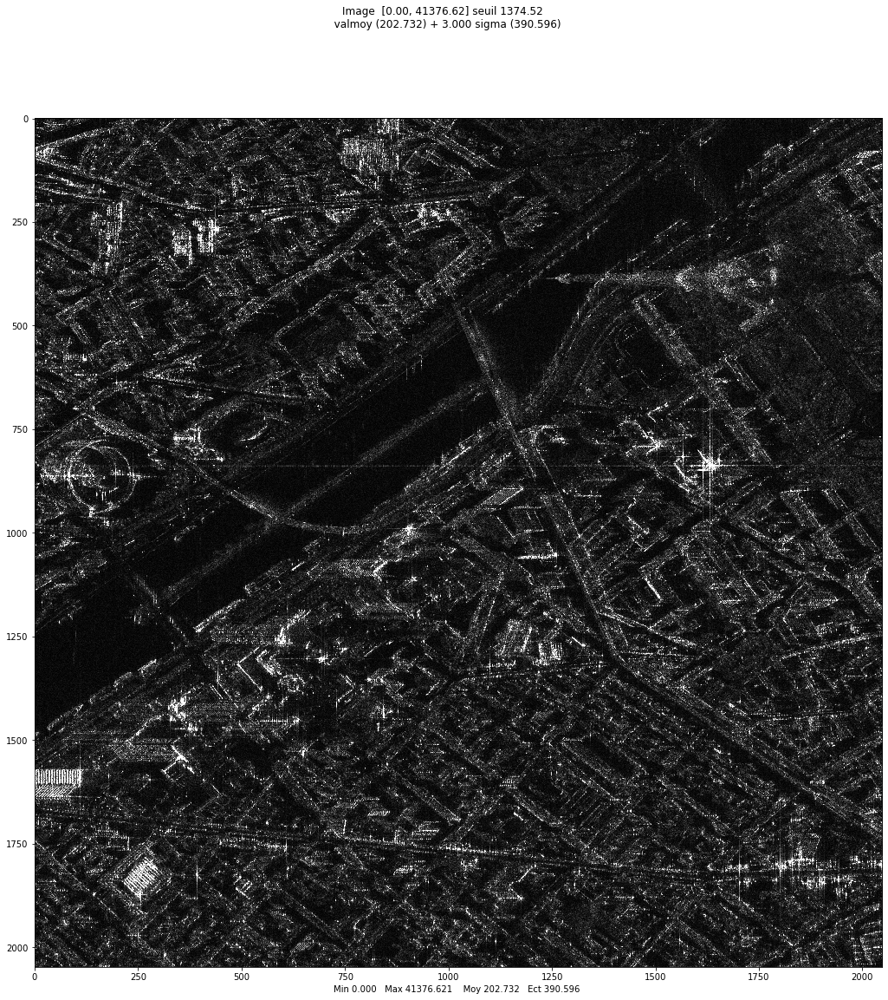

array([[ 58.30951895,  59.07622195, 145.77379737, ...,  22.84731932,
         42.05948169,   5.83095189],
       [ 90.00555538,  64.77653896, 117.08543889, ...,  41.76122604,
         17.80449381,   2.        ],
       [259.49373788, 153.83432647,  92.00543462, ..., 129.18978288,
         80.80222769,  43.18564576],
       ...,
       [132.37069162, 283.06359709, 409.33238328, ...,  88.05112151,
         62.03224968,  11.04536102],
       [ 36.76955262, 239.15058018, 382.41469637, ...,  11.        ,
         44.72135955,  10.        ],
       [100.56838469, 189.78145326, 234.04700383, ...,  17.49285568,
         94.42986816,   8.60232527]])

In [16]:
# 21 images from TerraSAR-X between 2009-01-24 and 2010-11-26
webpage='https://perso.telecom-paristech.fr/tupin/TPSAR/paris/'
image='PileiEiffeljavelRECALZ4RECSP.IMA'
im_slc_tsx_paris_liste=mvalab.imz2mat(webpage+image);
im_slc_tsx_paris = im_slc_tsx_paris_liste[0][:,:,0]
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visusar(np.abs(im_slc_tsx_paris))

### Question 2.1: interpretation
Check that you recognize the main buildings on this image. 
What is the position of the track of the sensor relatively to this image ?

Explain the appearence of the following buildings in the amplitude image : Eiffel Tower, Maison de la radio, Pont de Bir-Hakeim (you can use a [satellite optic image on googlemaps](https://www.google.com/maps/place/Eiffel+Tower/@48.851143,2.2797819,447m/data=!3m1!1e3!4m5!3m4!1s0x47e66e2964e34e2d:0x8ddca9ee380ef7e0!8m2!3d48.8583701!4d2.2944813) to help you).



### Answer 2.1
The Eiffel Tower and the Maison de la Radio are very recognizable. The orientation of the Eiffel Tower allows us to clearly state that the satellite is taking the image from the right.  
The Eiffel Tower, with its high number of metallic edges, reflects to the captor a lot and appears very clearly. Same thing for the Maison de la Radio and the Bir-Hakeim bridge.

### Question 2.2: change detection
Identify and explain the appearence of some changing objects on Paris.

### Answer 2.2
We see that most of the urban scene is not changing, but the boats are only present in some of frames. We can also note some buildings or roads (neir the eiffel tower) that have changed, maybe this can be caused to building or road works.

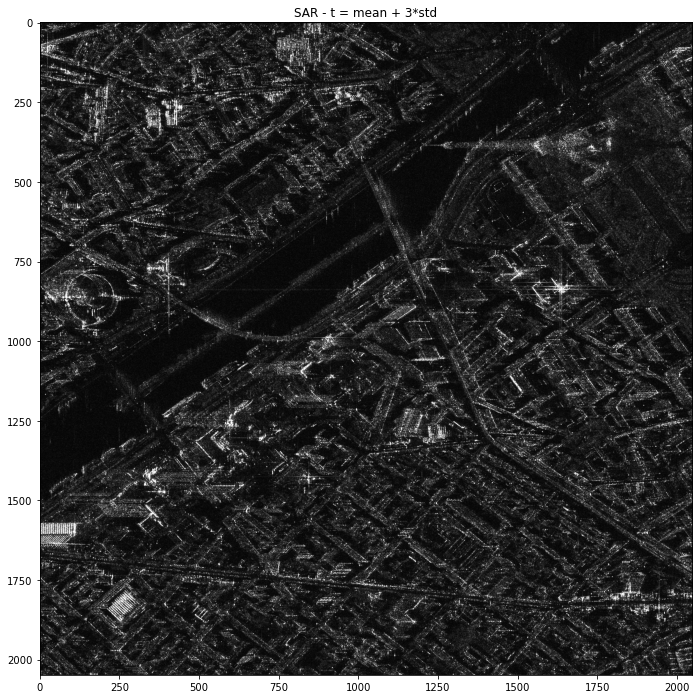

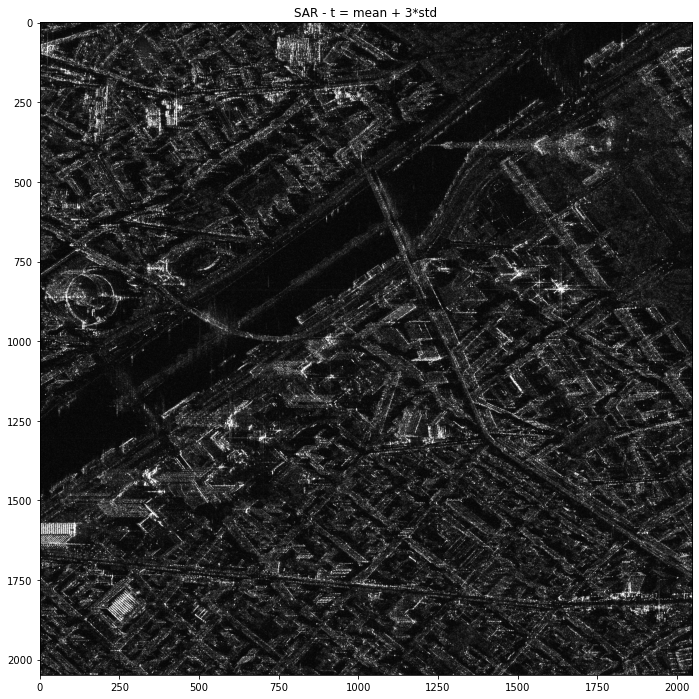

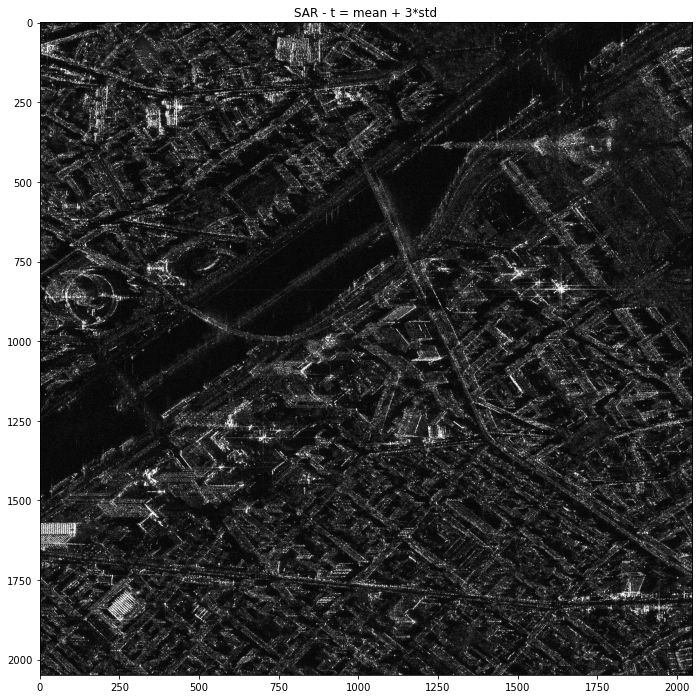

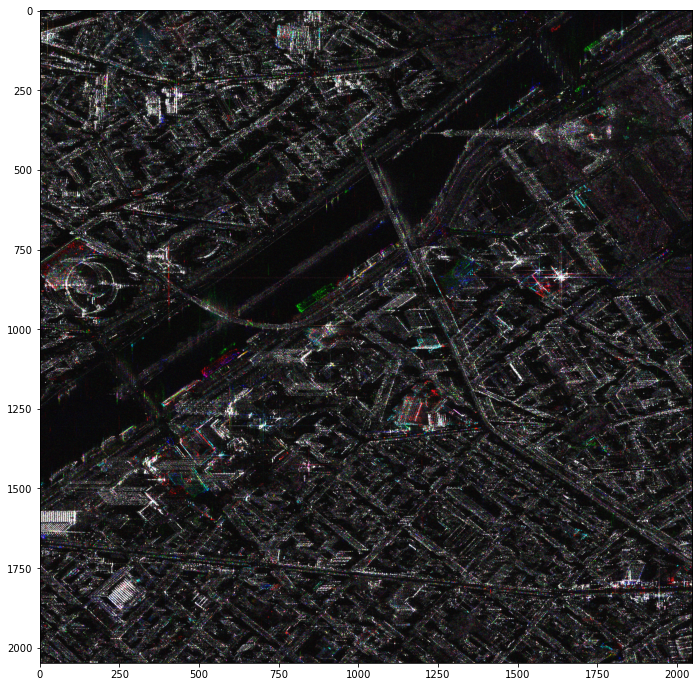

In [17]:
idx1 = 1 
idx2 = 10 
idx3 = 15
im1 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx1])
im2 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx2])
im3 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx3])

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

## 3. SAR interferometry
In this part, the objective is to see the content of the phase of a SAR image and to do a simple processing chain to obtain an interferogram with topographic fringes. 
You will be able to have a look to the optical image [on this link](https://g.page/ParcoEtna?share)

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


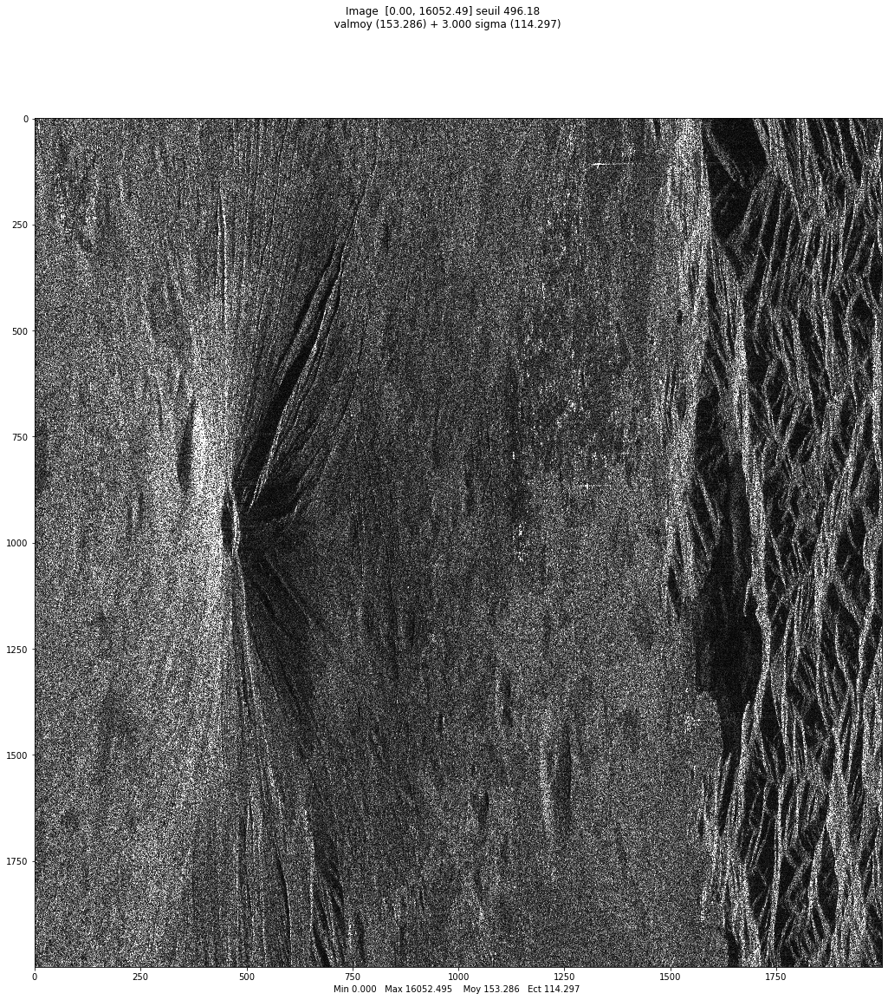

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


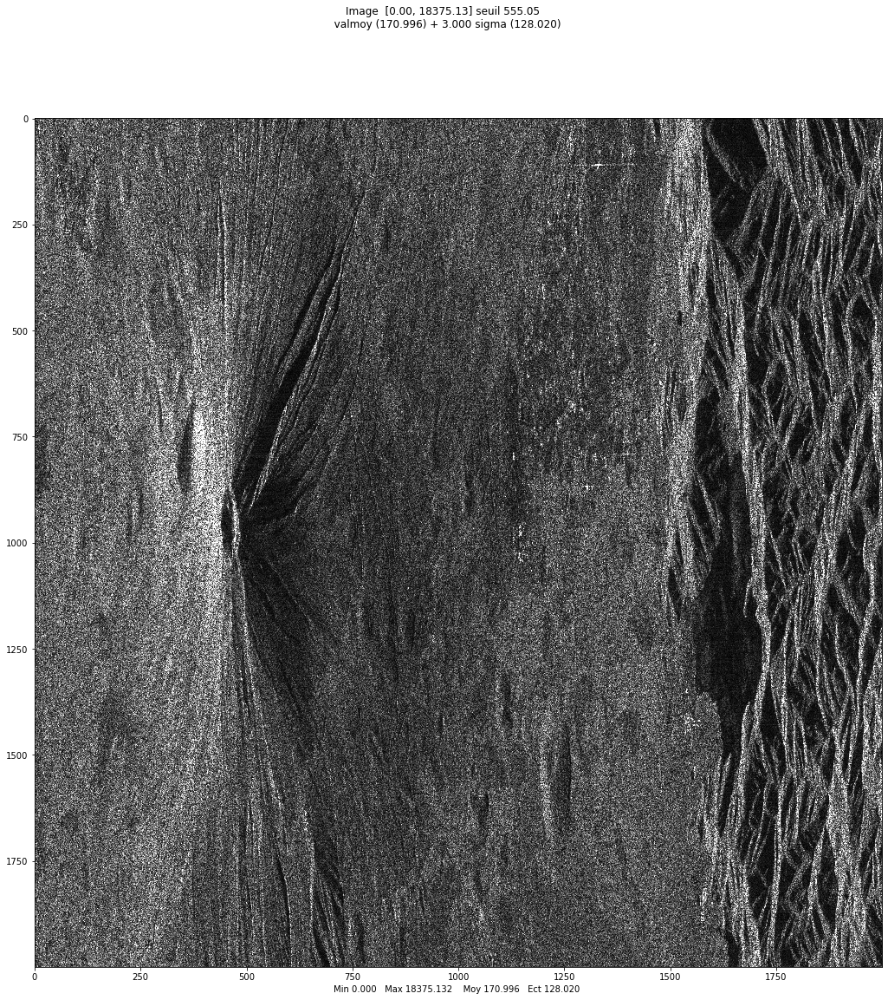

array([[246.54614173, 283.98943642,  94.86832981, ..., 499.65287951,
         82.00609733, 555.05417664],
       [257.41989045, 199.25109786, 141.73566947, ..., 399.60605601,
         55.        , 385.81083448],
       [146.10954794,  62.03224968,  77.79460136, ...,  67.08203932,
        205.24375752, 155.95512175],
       ...,
       [254.2380774 , 237.76669237, 199.58206332, ...,  72.9451849 ,
         43.68065934,  74.43117626],
       [182.00274723, 226.37358503, 142.5622671 , ...,  91.58602513,
         45.48626166,  31.        ],
       [ 57.97413216, 237.76038358, 143.58969322, ...,  72.99315036,
         74.72616677,  77.1038261 ]])

In [18]:
#!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Master.mat
#!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Slave.mat
imageM='./Master.mat'
imageS='./Slave.mat'
imamaitre=mvalab.matlab2imz(imageM,'Master')
imaslave=mvalab.matlab2imz(imageS,'Slave')

imamaitre = imamaitre[0][1000:3000,:]
imaslave = imaslave[0][1000:3000,:]
ncolonnes=imamaitre.shape[1]
nlignes=imamaitre.shape[0]

#%%
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visusar(imamaitre)
mvalab.visusar(imaslave)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


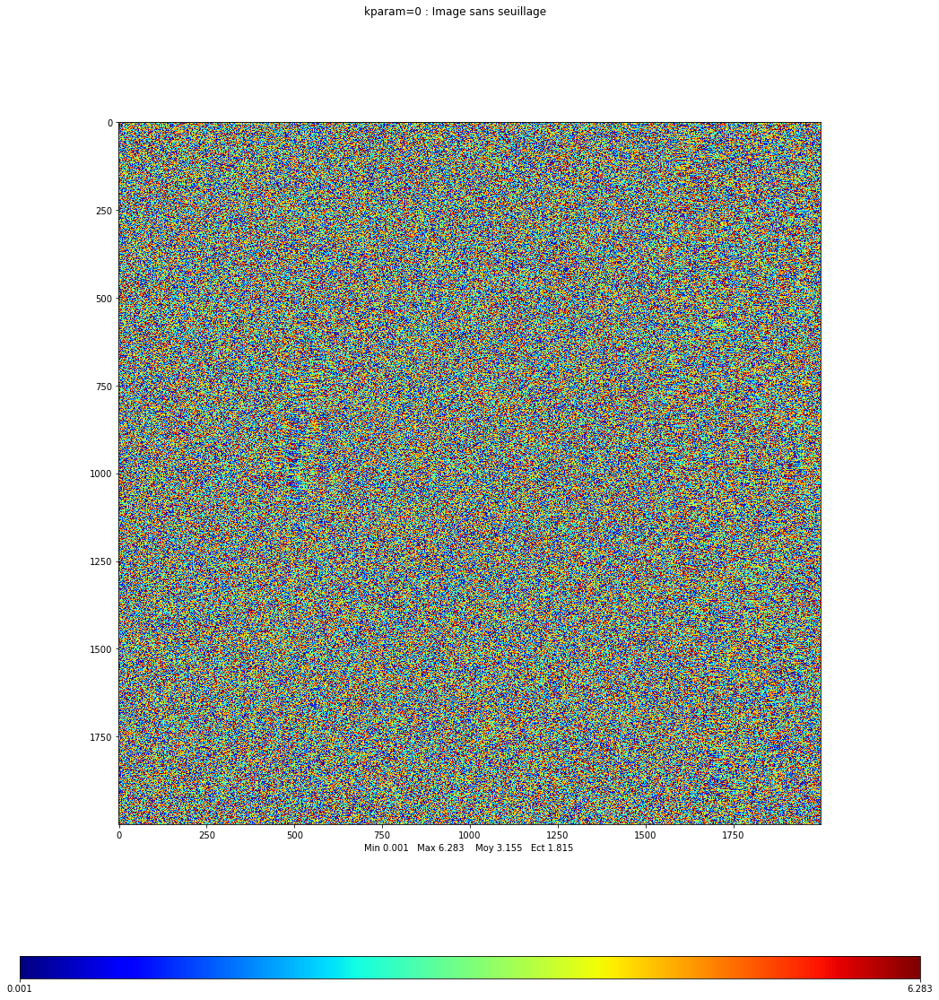

array([[6.12759048, 4.74305421, 4.41221781, ..., 1.9513027 , 5.200422  ,
        6.0785435 ],
       [0.78539816, 0.03569911, 0.609806  , ..., 2.89193238, 2.15744024,
        1.01336524],
       [1.61077501, 2.02577363, 2.68329259, ..., 5.24820022, 4.04275003,
        3.41047529],
       ...,
       [1.85360554, 1.2715139 , 1.81236203, ..., 3.18807078, 5.0244311 ,
        5.62461942],
       [4.13432394, 2.56347441, 0.83571537, ..., 0.14888995, 0.54937448,
        1.62479783],
       [0.04521802, 3.98984498, 3.34584682, ..., 2.89161403, 0.70862627,
        5.60998996]])

In [17]:
# display the phase of one image
#mvalab.visuinterfero uses an adapted lut to see the phase of an image
mvalab.visuinterfero(np.angle(imamaitre)+math.pi,0)

### Question 3.1
Do you recognize the area in the amplitude images ? Give a short interpretation. Visualize the phase of an image. Do you see any useful information?

### Answer 3.1
In the amplitude images, we clearly see the Etna volcano.  
We can only recognize the area of the crater, but the phase is too noisy.

### Question 3.2
Compute the interferogram by computing $z_1.z_2^*$ and display the phase. Do you see any structured pattern ?

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


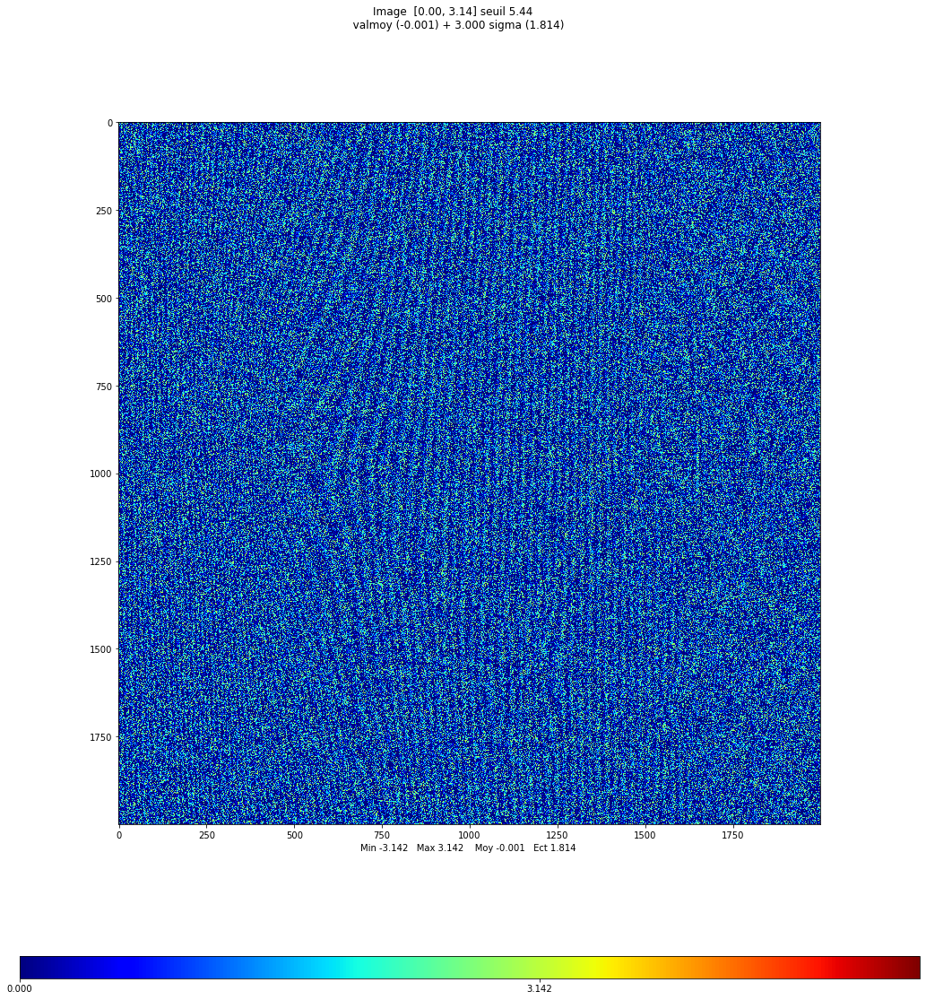

array([[5.44027968, 0.        , 0.        , ..., 0.        , 0.        ,
        0.25048328],
       [0.        , 0.        , 0.01006225, ..., 0.        , 0.        ,
        0.        ],
       [2.8468345 , 0.        , 0.30891828, ..., 0.99945885, 0.94989923,
        1.5869244 ],
       ...,
       [0.        , 0.        , 3.0408085 , ..., 0.        , 0.        ,
        1.44804168],
       [0.        , 0.        , 1.81072715, ..., 0.        , 0.        ,
        0.0540015 ],
       [0.        , 0.        , 3.04171558, ..., 0.        , 2.55036945,
        0.94950238]])

In [19]:
raw_interf = np.angle(imamaitre * np.conj(imaslave)) # compute z1.z2*
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visuinterfero(raw_interf) # diplay the phase 

### Answer 3.2
We see fringes that seems to embrace the level altitude lines.

### Question 3.3: Registration of the two images
To compute an interferogram, the following steps have to be applied :
- registration of the two images (only a translation is searched)
- suppression of the vertical fringe pattern 
- filtering to improve the phase information.

Using the knowledge acquired on previous courses, propose a method and apply it to do the registration between the two images. Complete the code below.

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


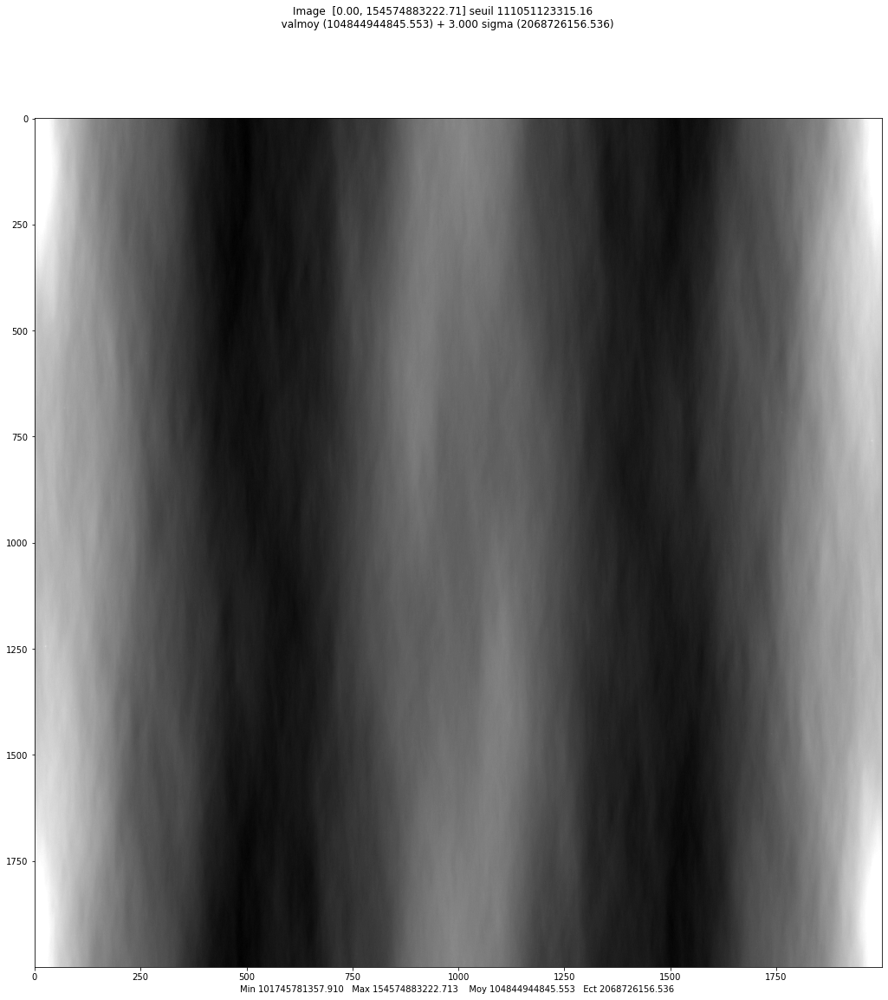

(2, 0)
Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


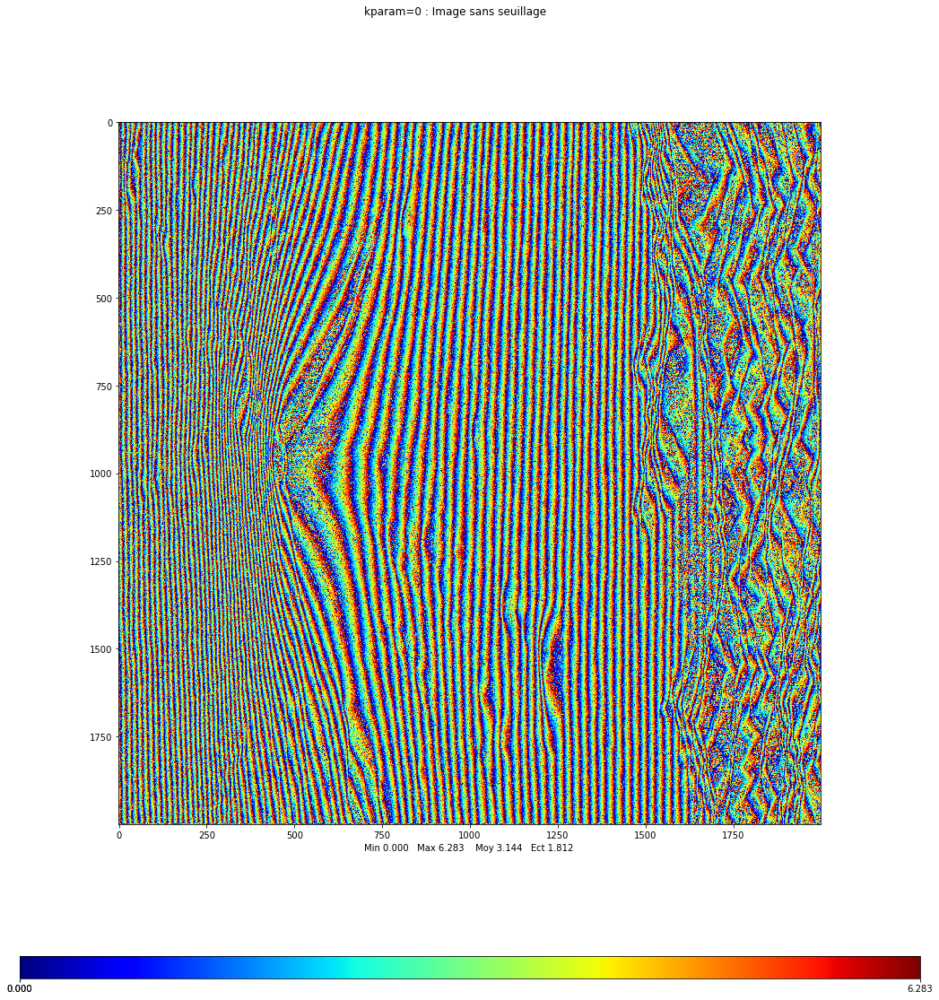

array([[4.22205732, 4.71080733, 5.17943616, ..., 0.84415399, 5.24916385,
        1.11339996],
       [4.88475065, 4.36758172, 4.71439299, ..., 5.99860473, 6.17553618,
        1.2324965 ],
       [4.49176528, 4.6466379 , 4.50604421, ..., 2.97654948, 0.68942589,
        1.65815508],
       ...,
       [3.68611537, 4.33310887, 4.64982345, ..., 3.02292211, 3.72458163,
        4.1057245 ],
       [0.56173994, 5.89279441, 4.58285269, ..., 1.30349405, 2.10797629,
        5.22151557],
       [0.1502983 , 5.18013493, 5.88769572, ..., 1.95881336, 0.06512516,
        0.96244501]])

In [20]:
# propose a method to extract the shift along the two axes
# to compute the correlation efficiently you can use the FFT 

# using the multiplication in the Fourier domain, compute the FFT of the correlation and then the correlation by inverse FFT
imacorfft =  np.fft.fft2(np.abs(imaslave)) * np.conj(np.fft.fft2(np.abs(imamaitre))) # to be completed
imacor= np.fft.ifft2(imacorfft) # to be completed

#visualize the correlation image (maximum gives the translation value)
mvalab.visusar(imacor)
ishift = np.unravel_index(np.argmax(imacor), imacor.shape) # you can use np.argmax and np.unravel_index
print(ishift)

# compute the shift on the two axis
imaslaveroll=np.roll(imaslave, -ishift[0], axis=0)
imaslaveroll=np.roll(imaslaveroll, -ishift[1], axis=1)

# compute the interferogram and plot the interferometric phase
interfero= np.conj(imaslaveroll) * imamaitre # to be completed
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)

### Question 3.4
What is the shift between the two images ? Which pattern do you see in the resulting fringes when computing the interferogram after the registration ? 

### Answer 3.4
We have a shift of 2 pixels over the horizontal axis. That is why wee see vertical fringes on the intergerogram.

### Question 3.5: Suppression of the orbital fringes 
To obtain the useful information about the topography the so-called orbital fringes have to be suppressed. It can be done by using the sensor parameters but in this practical work we propose to use a signal processing method. 
How can you detect a pure sinusoid in a signal ? (it is the case of the pattern we would like to suppress in the horizontal direction). Compute the frequency of this pattern and use it to suppress it in the registered secondary image. 

Which frequency did you obtain ? Is it the same for all the considered lines ? What do you see in the resulting interferogram after correction ? 

C:\ProgramData\Anaconda3\lib\site-packages\numpy\ma\core.py:3377: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\cbook\__init__.py:1333: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\cbook\__init__.py:1333: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


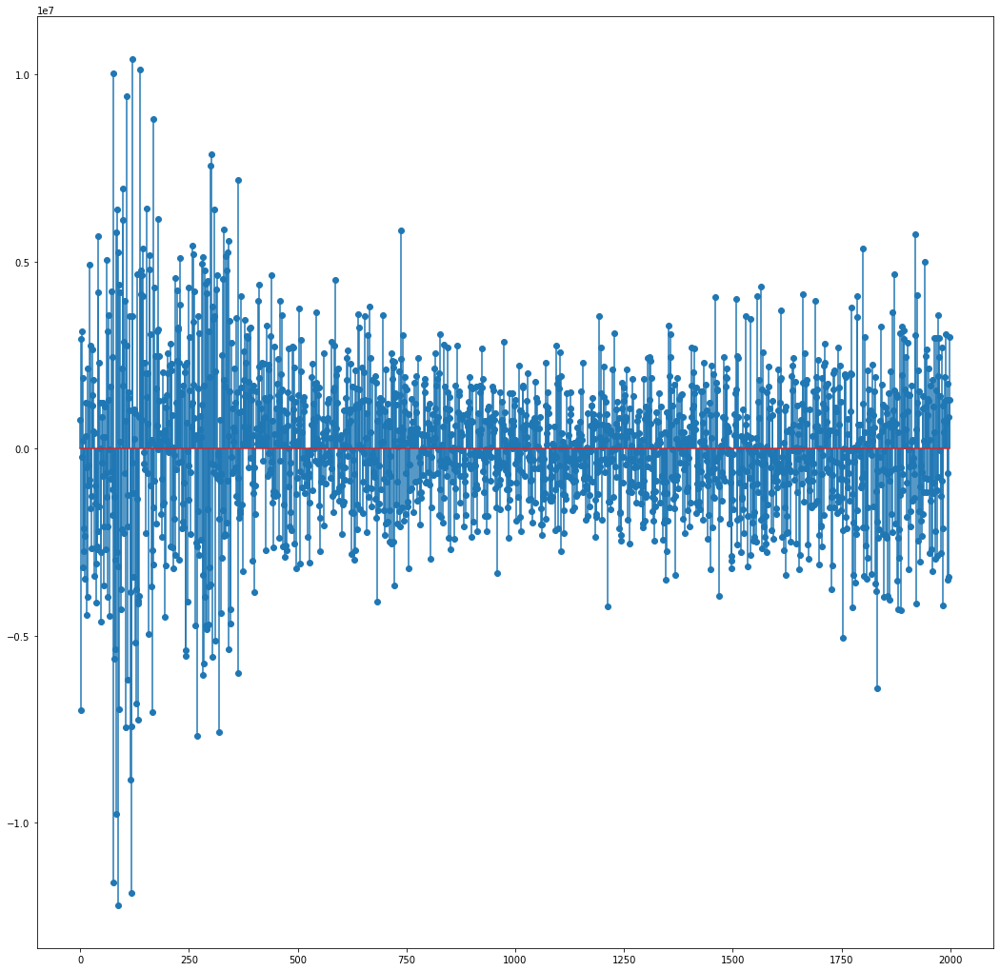

(88,)


In [21]:
# compute the main frequency of the pattern by choosing a line in the image and using the FFT
fftfringe = np.fft.fft(interfero[10, :]) # to be completed
plt.figure()
plt.stem(fftfringe)
plt.show()
freq = np.unravel_index(np.argmax(np.abs(fftfringe)), fftfringe.shape)
print(freq)

### Answer 3.5a 
For the line 10, we obtain a frequency of $88$, but it is not exactly the same for all lines.

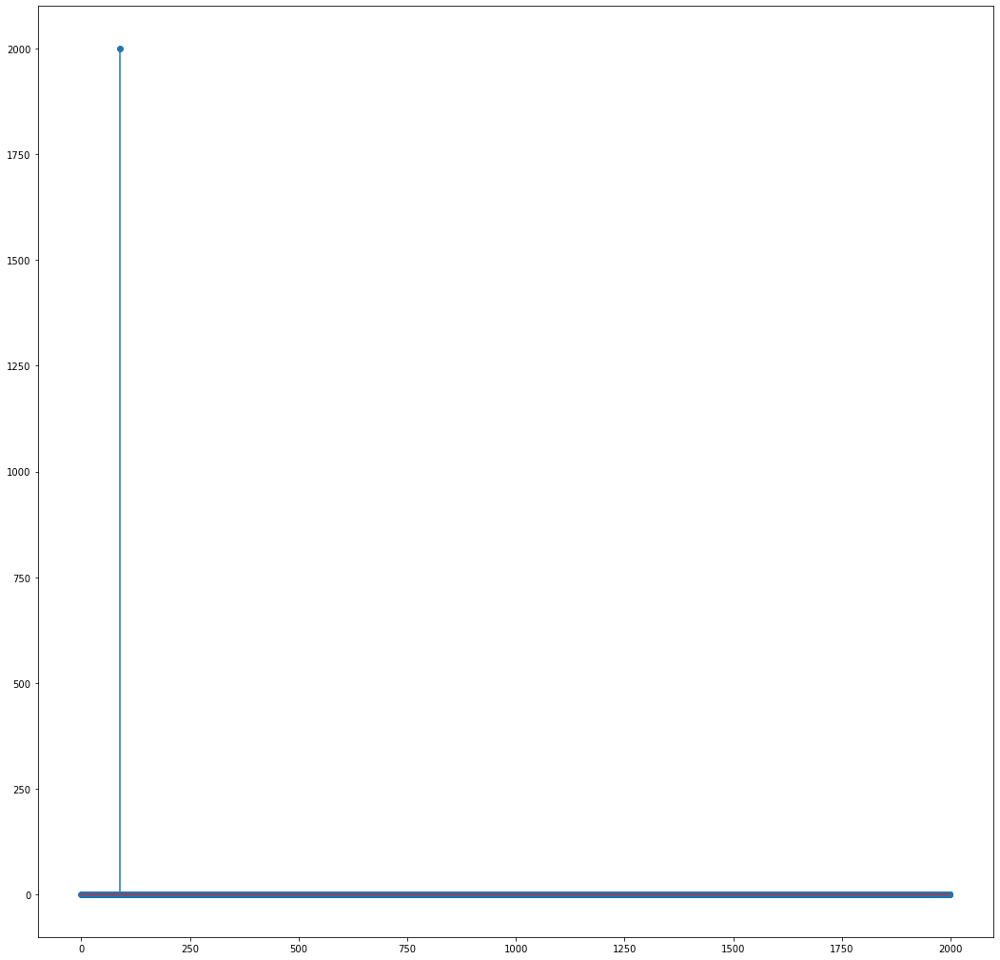

In [43]:
N = interfero.shape[1]
n = np.arange(0,N)
onde = np.exp(2j*np.pi*n/N*freq) # create a pure wave using the previously computed frequency freq 
fonde = np.abs(np.fft.fft(onde))
plt.figure()
plt.stem(fonde)
plt.show()

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


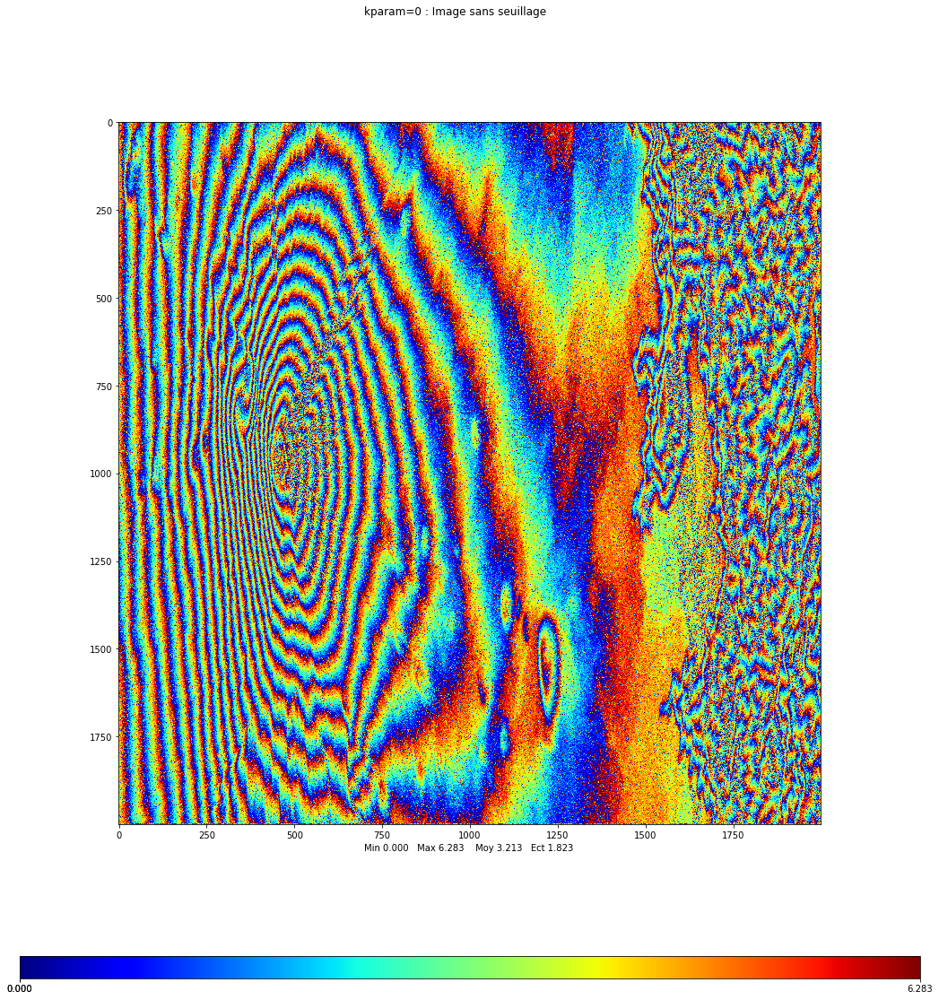

array([[4.22205732, 4.43434718, 4.62651585, ..., 1.67353445, 5.80208416,
        1.38986011],
       [4.88475065, 4.09112156, 4.16147268, ..., 0.54479989, 0.44527118,
        1.50895666],
       [4.49176528, 4.37017774, 3.9531239 , ..., 3.80592994, 1.24234619,
        1.93461524],
       ...,
       [3.68611537, 4.05664871, 4.09690315, ..., 3.85230257, 4.27750193,
        4.38218465],
       [0.56173994, 5.61633426, 4.02993238, ..., 2.13287451, 2.6608966 ,
        5.49797572],
       [0.1502983 , 4.90367477, 5.33477542, ..., 2.78819382, 0.61804547,
        1.23890516]])

In [42]:
# suppress the pattern by multiplying the interferogram by the conjugate of the pure wave
interferofine= np.multiply(interfero, np.conj(onde))

mvalab.visuinterfero(np.angle(interferofine)+math.pi,0)

### Answer 3.5b 
After removing the frequency, we see on the interferogram that fringes have become circular, and that represents better the real level line of altitude of the volcano.

### Question 3.6: interferogram filtering
To improve the quality of the interferogram, some filtering can be applied to reduce the phase noise. Propose a suitable kernel by filling the code below.

How does the filtered interferogram look like?

### Answer 3.6
We can use a median filter with a simple kernel of size $3\times 3$ to filter out the noise.  
The resulting interferogram is less noisy that the one we had before, but areas where noise was predominant has been more deteriorated (median filter cons).

In [48]:
def interferogramme( tabvignette, tabvignette2, *therest) :
    """
    Computation of the complex interferogram between two images of the
    same size.
    By default, window size is set as 3x3 (dimx, dimy).
    It outputs a complex image, whose modulus is the coherence and whose phase 
    is the interferometric phase.
    """
    
    dimx=3
    dimy=3
    
    if(len(therest)==1):        
        dimx=therest[0]
        dimy=dimx
        
    if(len(therest)==2):       
        dimx=therest[0]
        dimy=therest[1]
    
    nlig=np.size(tabvignette,0)
    ncol=np.size(tabvignette,1)
    
    if nlig != np.size(tabvignette2,0)  :
        print(u'les deux images doivent avoir la même taille (%d  et %d)'%(nlig, np.size(tabvignette2,0)))
        return 0
    
    if ncol != np.size(tabvignette2,1)  :
        print(u'les deux images doivent avoir la même taille')
        return 0
    
    interf= np.multiply(tabvignette, np.conj(tabvignette2))

    # part to be completed to compute a multi-look interfergram by averaging on a local window
    
    
    mask = np.ones((3, 3)) / 9 # to be completed
    interfiltr = signal.convolve2d(interf,mask,mode='same')
    
    den1 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette)),mask,mode='same'))
    den2 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette2)),mask,mode='same'))
 
    return interfiltr/(den1*den2+1e-12)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


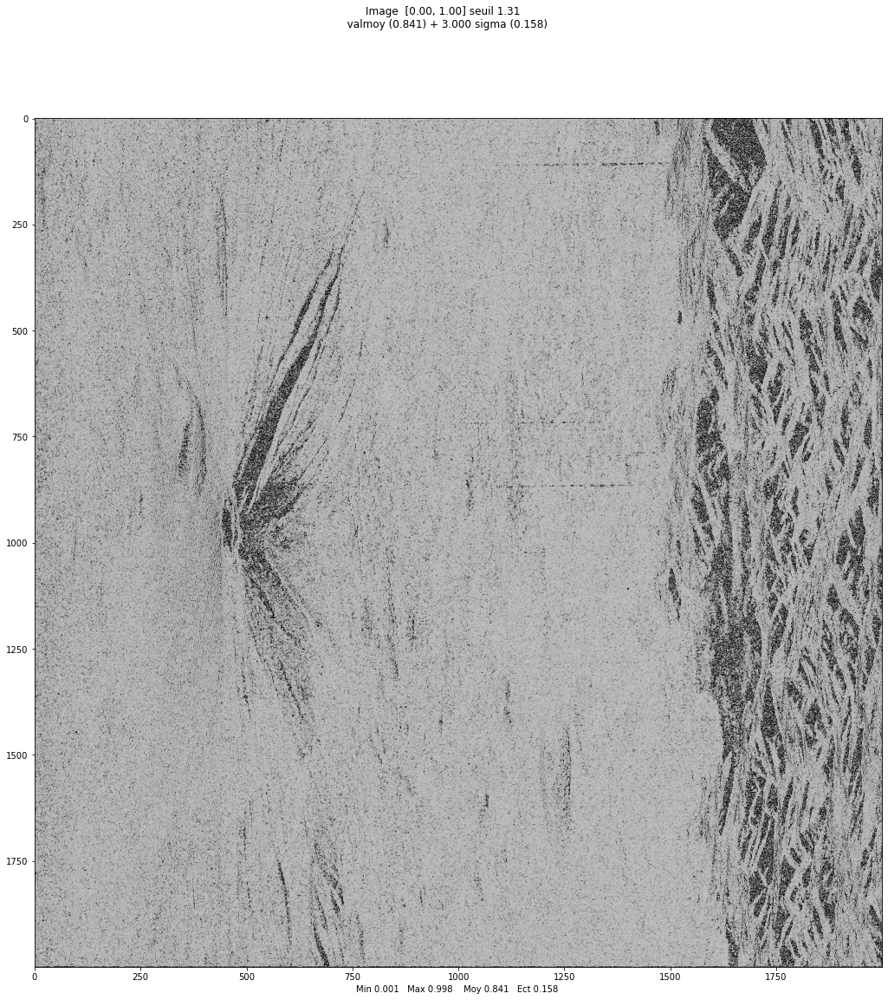

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


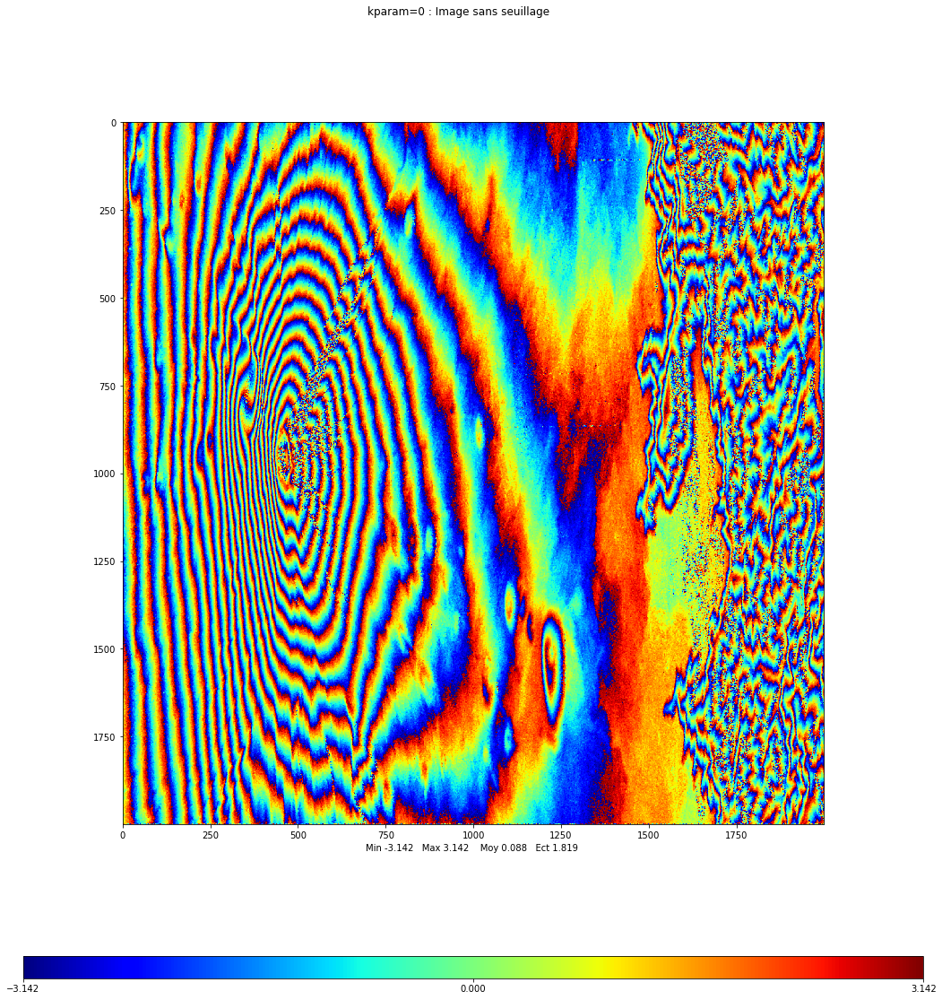

array([[ 1.2279969 ,  1.21967119,  1.65677293, ..., -2.47301535,
        -2.29274868, -2.20971056],
       [ 1.25835103,  1.2242175 ,  1.51653665, ..., -2.43612639,
        -2.12147544, -1.99736159],
       [ 1.49096764,  1.41154218,  1.4575004 , ..., -2.62105169,
        -2.357279  , -2.12231918],
       ...,
       [ 1.12950458,  1.0649053 ,  1.15034095, ...,  0.12188607,
         0.68587499,  1.86577684],
       [ 2.47500127,  2.29224644,  1.45834327, ..., -0.01770806,
        -0.95581559, -2.93627923],
       [ 3.06177211,  2.91110301,  2.10977673, ..., -0.24029512,
        -1.21612621, -2.57514978]])

In [49]:
imaslavefine= np.multiply(imaslaveroll,onde)
filtered_interferogram = interferogramme(imamaitre,imaslavefine)
mvalab.visusar(np.abs(filtered_interferogram))
mvalab.visuinterfero(np.angle(filtered_interferogram),0)

### Question 3.7
Can you apply the convolution directly on the interferometric phase image ? 
What would happen in that case?

### ANSWER 3.7
Well, if we try do to do, the ability to manipulate the phase of a signal independently from its amplitude is lost. So it does not work

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


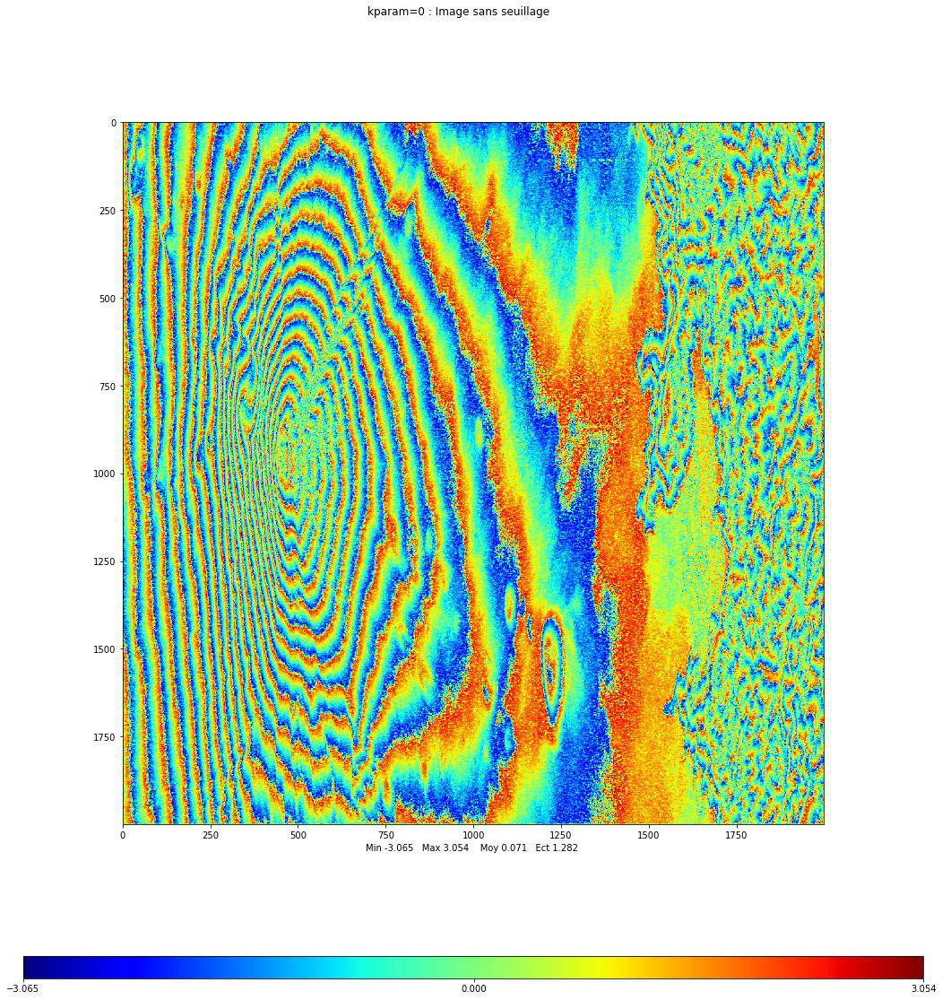

array([[ 0.56287845,  0.84118992,  1.05378919, ..., -0.92744366,
        -0.83167217, -0.38002206],
       [ 0.84940709,  1.2178887 ,  1.38402861, ..., -1.31905642,
        -1.1029929 , -0.72515804],
       [ 1.00564643,  1.35102241,  1.34188545, ..., -1.536598  ,
        -1.90272417, -1.37770624],
       ...,
       [ 0.27265684,  0.54995085,  1.14447631, ...,  0.43220859,
         0.8657699 ,  0.91313748],
       [ 0.01391727,  0.46245427,  1.14010798, ..., -0.04476655,
        -0.09171705, -0.01933849],
       [-0.14825815,  0.19413324,  0.80392039, ..., -0.43609827,
        -0.43474051, -0.28339418]])

In [50]:
angle_filtered_interferogram = np.angle(interferofine)
mask = np.ones((3, 3)) / 9 # to be completed
interfiltr = signal.convolve2d(angle_filtered_interferogram, mask, mode='same')
mvalab.visuinterfero(interfiltr, 0)